## 1. Defining the Question

### a) Specifying the Question

### b) Defining the Metric for Success

### c) Understanding the context 


### d) Recording the Experimental Design


### e) Data Relevance


## Importing Libraries

In [ ]:
pip install -U pandas-profiling

In [2]:
#Importing libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb
import pandas_profiling
sb.set_style()
import warnings
warnings.filterwarnings("ignore")

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


## 2. Loading and previewing the data set

In [3]:
# previewing top of housing results data set
housing = pd.read_csv('house_data.csv')
housing.head()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [4]:
# preview last five rows
housing.tail()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
21608,263000018,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,402101.0,2,0.75,1020,1350,2.0,0,0,3,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,400000.0,3,2.50,1600,2388,2.0,0,0,3,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287
21612,1523300157,325000.0,2,0.75,1020,1076,2.0,0,0,3,7,1020,0,2008,0,98144,47.5941,-122.299,1020,1357


In [5]:
# checking the shape of our datasets
print('Housing data set rows & columns:', housing.shape)

Housing data set rows & columns: (21613, 20)


In [6]:
# checking the data types
housing.dtypes

id                 int64
price            float64
bedrooms           int64
bathrooms        float64
sqft_living        int64
sqft_lot           int64
floors           float64
waterfront         int64
view               int64
condition          int64
grade              int64
sqft_above         int64
sqft_basement      int64
yr_built           int64
yr_renovated       int64
zipcode            int64
lat              float64
long             float64
sqft_living15      int64
sqft_lot15         int64
dtype: object

A quick overview of the data set indicates that the table has 21,613 rows and 20 columns. All the columns in the data set have a numerical data type although the house ID, and the ZipCode hold categorical information.

## 3. External Data Source Validation


## 4. Tidying the Dataset


### a. Match Results dataset

In [7]:
# checking for null values in the results dataset
housing.isna().sum()

id               0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

There are no null values in the dataset

In [8]:
# checking duplicates
print(housing.duplicated().sum(), 'duplicates in the data set')
# removing duplciates
housing = housing.drop_duplicates()
# checking duplicates
print(housing.duplicated().sum(), 'duplicates in the data set')

3 duplicates in the data set
0 duplicates in the data set


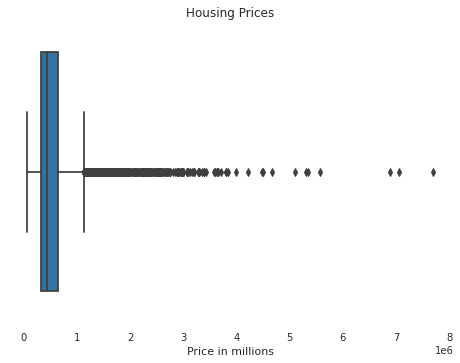

In [10]:
# checking outliers
sb.boxplot(x=housing['price'])
plt.xlabel('Price in millions')
plt.title('Housing Prices')
plt.show()

In [12]:
#compute IQR to remove outliers
q1_diff, q3_diff = np.percentile(housing['price'], [25, 75])
iqr_diff = q3_diff - q1_diff

lower_diff = q1_diff - (1.5 * iqr_diff)
upper_diff = q3_diff + (1.5 * iqr_diff)
lower_diff, upper_diff

(-163468.75, 1130081.25)

In [15]:
housing_no_outliers = housing.drop(housing[housing['price'] > 1200000].index)
print(housing.shape)
print(housing_no_outliers.shape)

(21610, 20)
(20631, 20)


## 5. Exporatory Data Analysis

In [26]:
# creating a profile report for the data set
from pandas_profiling import ProfileReport
profile = ProfileReport(housing, title='Housing Profile Report')

In [27]:
report = profile.to_notebook_iframe()
report

In [28]:
# save profile repot as html file
profile.to_file("Housing Profile Report.html")

In [29]:
housing.drop('price', 1).corr()

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
id,1.000000,0.001354,0.005093,-0.012239,-0.132101,0.018482,-0.002717,0.011785,-0.023686,0.008093,-0.010857,-0.005084,0.021218,-0.016688,-0.008129,-0.001861,0.020776,-0.002869,-0.138778
bedrooms,0.001354,1.000000,0.515935,0.576674,0.031699,0.175448,-0.006583,0.079433,0.028422,0.357003,0.477619,0.303077,0.154276,0.018695,-0.152721,-0.008953,0.129474,0.391633,0.029233
bathrooms,0.005093,0.515935,1.000000,0.754688,0.087750,0.500669,0.063747,0.187891,-0.124940,0.664990,0.685351,0.283814,0.505997,0.050879,-0.203831,0.024590,0.223047,0.568665,0.087191
sqft_living,-0.012239,0.576674,0.754688,1.000000,0.172830,0.353954,0.103820,0.284641,-0.058768,0.762719,0.876600,0.435054,0.318099,0.055314,-0.199435,0.052521,0.240221,0.756420,0.183285
sqft_lot,-0.132101,0.031699,0.087750,0.172830,1.000000,-0.005171,0.021601,0.074753,-0.008967,0.113644,0.183527,0.015271,0.053105,0.007677,-0.129611,-0.085680,0.229552,0.144620,0.718556
floors,0.018482,0.175448,0.500669,0.353954,-0.005171,1.000000,0.023711,0.029325,-0.263779,0.458151,0.523874,-0.245673,0.489347,0.006156,-0.059025,0.049593,0.125343,0.279861,-0.011250
waterfront,-0.002717,-0.006583,0.063747,0.103820,0.021601,0.023711,1.000000,0.401993,0.016652,0.082785,0.072080,0.080585,-0.026159,0.092950,0.030277,-0.014272,-0.041904,0.086469,0.030702
view,0.011785,0.079433,0.187891,0.284641,0.074753,0.029325,0.401993,1.000000,0.045836,0.251378,0.167659,0.276996,-0.053229,0.103208,0.084838,0.006049,-0.078560,0.280404,0.072577
condition,-0.023686,0.028422,-0.124940,-0.058768,-0.008967,-0.263779,0.016652,0.045836,1.000000,-0.144655,-0.158212,0.174071,-0.361347,-0.060862,0.002962,-0.014971,-0.106512,-0.092854,-0.003424
grade,0.008093,0.357003,0.664990,0.762719,0.113644,0.458151,0.082785,0.251378,-0.144655,1.000000,0.755919,0.168443,0.446966,0.014372,-0.184795,0.114086,0.198347,0.713208,0.119265


## 6. Modelling

In [30]:
#Checking multicolineraity assumption
from statsmodels.stats.outliers_influence import variance_inflation_factor
variables = housing[['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot',
       'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat']]
vif = pd.DataFrame()
vif['VIF'] = [variance_inflation_factor(variables.values, i) for i in range(variables.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif['features'] = variables.columns
vif

,VIF,features
0,23.22,bedrooms
1,28.54,bathrooms
2,inf,sqft_living
3,1.21,sqft_lot
4,16.33,floors
5,1.21,waterfront
6,1.52,view
7,34.68,condition
8,134.14,grade
9,inf,sqft_above


### a. Multiple Linear Regression model

In [16]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Ridge
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

In [17]:
# assign features and target
X = housing_no_outliers.drop(['price', 'id'], 1)
y = housing_no_outliers['price']

In [18]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X)
X_std = scaler.transform(X)

In [19]:
# Dividing our data into training and test sets
# ---
# 
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_std, y, test_size=0.2, random_state=0)

In [20]:
# Training the Algorithm
# ---
# To train the algorithm we execute the same code as before, using the fit() method of the LinearRegression class
# ---
# 
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [21]:
# In case of multivariable linear regression, the regression model has to 
# find the most optimal coefficients for all the attributes. 
# To see what coefficients our regression model has chosen, execute the following
# 
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Multiple Linear Coefficient'])
coeff_df

,Multiple Linear Coefficient
bedrooms,-8165.762027
bathrooms,16896.724820
sqft_living,30447.717589
sqft_lot,10554.277315
floors,18197.032920
waterfront,9122.764084
view,20500.826701
condition,16516.987671
grade,79783.075111
sqft_above,24630.157754


In [22]:
# Making Predictions
y_pred = regressor.predict(X_test)

# To compare the actual output values for X_test with the predicted values
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
df

,Actual,Predicted
14065,550120.0,596852.931034
1962,605000.0,594047.666608
17946,275000.0,211041.739271
5416,785000.0,698989.054597
2628,455000.0,460968.262373
...,...,...
1511,390000.0,357628.375520
4338,380000.0,395817.207594
13632,675750.0,646808.346908
11197,344950.0,412367.661023


In [23]:
# Evaluating the Algorithm
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 90066.87657859449
Mean Squared Error: 14399539709.393124
Root Mean Squared Error: 119998.08210714505


In [24]:
# check model score
regressor.score(X_test, y_test)

0.7009270636767819

## Quantile Regression

In [ ]:
housing1 = housing.drop('id', 1)
housing1

In [ ]:
# assign features and target
x = housing1[['bedrooms', 'bathrooms', 'sqft_living',	'sqft_lot',	'floors',	'waterfront',	'view',	'condition', 'grade',	'sqft_above']]
y = housing1['price']

In [ ]:
import statsmodels.formula.api as smf

# Finding the regression coefficients for the conditioned median, 0.5 quantile
mod = smf.quantreg('y ~ x', housing1)
res = mod.fit(q=0.5)

# Then print out the summary of our model
print(res.summary())

## Ridge Regression

In [26]:
# assign features and target
X = housing_no_outliers.drop(['price', 'id'], 1)
y = housing_no_outliers['price']

In [27]:
scaler = StandardScaler()
scaler.fit(X)
X_std = scaler.transform(X)

In [28]:
# Dividing our data into training and test sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [29]:
ridge = Ridge(normalize=True)
search = GridSearchCV(estimator=ridge,param_grid={'alpha':np.logspace(-5,2,8)},scoring='neg_mean_squared_error',n_jobs=1,refit=True,cv=10)

search.fit(X_train,y_train)
print('best parameters:', search.best_params_)

best parameters: {'alpha': 0.001}


In [31]:
ridge = Ridge(normalize=True,alpha=0.001)
ridge.fit(X_train,y_train)
second_model = (mean_squared_error(y_true=y_test,y_pred=ridge.predict(X_test)))
print(second_model)
ridge.score(X_test,y_test)

14398037865.372486


0.7009582564030925

In [32]:
# To see what coefficients our regression model has chosen, execute the following
# 
coeff_df2 = pd.DataFrame(ridge.coef_, X.columns, columns=['Ridge Coefficient'])
coeff_df3 = pd.concat([coeff_df, coeff_df2], axis=1)
coeff_df3

,Multiple Linear Coefficient,Ridge Coefficient
bedrooms,-8165.762027,-8888.019093
bathrooms,16896.724820,23542.666588
sqft_living,30447.717589,38.717069
sqft_lot,10554.277315,0.262326
floors,18197.032920,33824.341121
waterfront,9122.764084,156705.425886
view,20500.826701,31352.763593
condition,16516.987671,25527.010775
grade,79783.075111,75449.220370
sqft_above,24630.157754,33.324552


## Lasso Regression

In [33]:
from sklearn.linear_model import Lasso
from sklearn.preprocessing import StandardScaler

In [34]:
# assign features and target
X = housing_no_outliers.drop(['price', 'id'], 1)
y = housing_no_outliers['price']

In [35]:
# Before building the models, let's first scale data. 
# Lasso put constraints on the size of the coefficients associated to each variable. 
# But, this value depends on the magnitude of each variable and it is therefore 
# necessary to center and reduce, or standardize, the variables.
#from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(X)
X_std = scaler.transform(X)

In [36]:
from sklearn import linear_model
from sklearn.metrics import mean_squared_error

# Creating lasso object
lasso = linear_model.Lasso() 

# Fitting the models
lasso.fit(X_std, y) 

# Print scores and MSE
print("lasso score:", lasso.score(X_std, y)) 
print("lasso MSE:", mean_squared_error(y, lasso.predict(X_std)))  

lasso score: 0.7024574234414416
lasso MSE: 13972434063.990248


In [37]:
# comparing regression model coefficients
coeff_df3['Lasso Coefficients'] = lasso.coef_
coeff_df3

,Multiple Linear Coefficient,Ridge Coefficient,Lasso Coefficients
bedrooms,-8165.762027,-8888.019093,-8765.238221
bathrooms,16896.724820,23542.666588,16496.028196
sqft_living,30447.717589,38.717069,117724.518466
sqft_lot,10554.277315,0.262326,9262.289792
floors,18197.032920,33824.341121,18202.800239
waterfront,9122.764084,156705.425886,8773.295648
view,20500.826701,31352.763593,20647.687819
condition,16516.987671,25527.010775,17345.287908
grade,79783.075111,75449.220370,78719.023377
sqft_above,24630.157754,33.324552,-55659.421204


In [38]:
# Dividing our data into training and test sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_std, y, test_size=0.2, random_state=0)

In [52]:
# Define GridSearch parameters
from sklearn import linear_model

parameters = {'alpha': np.concatenate((np.arange(0.1,2,0.1), np.arange(2, 5, 0.5), np.arange(5, 25, 1)))}
lasso = linear_model.Lasso() 
gridlasso = GridSearchCV(lasso, parameters, scoring ='r2')
gridlasso.fit(X_train, y_train) 
gridlasso.best_params_

{'alpha': 2.5}

In [54]:
lasso = linear_model.Lasso(alpha=2.5)
lasso.fit(X_train, y_train)

second_model = (mean_squared_error(y_true=y_test,y_pred=lasso.predict(X_test)))
print(second_model)
lasso.score(X_test,y_test)

14399457707.38712


0.7009287668271059

In [40]:
coeff_df3['Grid Lasso Coefficients'] = gridlasso.best_estimator_.coef_
coeff_df3

,Multiple Linear Coefficient,Ridge Coefficient,Lasso Coefficients,Grid Lasso Coefficients
bedrooms,-8165.762027,-8888.019093,-8765.238221,-8163.154660
bathrooms,16896.724820,23542.666588,16496.028196,16882.649983
sqft_living,30447.717589,38.717069,117724.518466,113851.567396
sqft_lot,10554.277315,0.262326,9262.289792,10546.513803
floors,18197.032920,33824.341121,18202.800239,18196.364238
waterfront,9122.764084,156705.425886,8773.295648,9120.679718
view,20500.826701,31352.763593,20647.687819,20500.395185
condition,16516.987671,25527.010775,17345.287908,16514.124541
grade,79783.075111,75449.220370,78719.023377,79787.806317
sqft_above,24630.157754,33.324552,-55659.421204,-53414.172093


In [41]:
print("lasso best parameters:", gridlasso.best_params_) 
print("lasso score:", gridlasso.score(X_test, y_test))
print("lasso MSE:", mean_squared_error(y_test, gridlasso.predict(X_test)))

lasso best parameters: {'alpha': 2.5}
lasso score: 0.7009287668271059
lasso MSE: 14399457707.38712


#### Model Evaluation

## Elastic Net Regression

In [42]:
# assign features and target
X = housing_no_outliers.drop(['price', 'id'], 1)
y = housing_no_outliers['price']

In [43]:
# Dividing our data into training and test sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_std, y, test_size=0.2, random_state=0)

In [44]:
# Elastic Net Model
# Elastic net, just like ridge and lasso regression, requires normalize data. 
# This argument  is set inside the ElasticNet function. 
# The second thing we need to do is create our grid.
# 
from sklearn.linear_model import ElasticNet

elastic=ElasticNet(normalize=True)
search=GridSearchCV(estimator=elastic,param_grid={'alpha':np.logspace(-5,2,8),'l1_ratio':[.2,.4,.6,.8]},scoring='neg_mean_squared_error',n_jobs=1,refit=True,cv=10)

In [45]:
# We will now fit our model and display the best parameters and the best results we can get with that setup.
# 
search.fit(X_train,y_train)
print(search.best_params_)
abs(search.best_score_)

{'alpha': 1e-05, 'l1_ratio': 0.8}


13930945604.25542

In [46]:
print("elastic best parameters:", search.best_params_) 
print("elastic best score:", search.score(X_test, y_test))
print("elastic MSE:", mean_squared_error(y_test, search.predict(X_test)))

elastic best parameters: {'alpha': 1e-05, 'l1_ratio': 0.8}
elastic best score: -14379689510.465784
elastic MSE: 14379689510.465784


In [51]:
coeff_df3['Grid Elastic Coefficients'] = search.best_estimator_.coef_
coeff_df3

,Multiple Linear Coefficient,Ridge Coefficient,Lasso Coefficients,Grid Lasso Coefficients,Grid Elastic Coefficients
bedrooms,-8165.762027,-8888.019093,-8765.238221,-8163.154660,-7194.971581
bathrooms,16896.724820,23542.666588,16496.028196,16882.649983,16094.305091
sqft_living,30447.717589,38.717069,117724.518466,113851.567396,31058.070782
sqft_lot,10554.277315,0.262326,9262.289792,10546.513803,9813.021166
floors,18197.032920,33824.341121,18202.800239,18196.364238,17293.701274
waterfront,9122.764084,156705.425886,8773.295648,9120.679718,8807.783934
view,20500.826701,31352.763593,20647.687819,20500.395185,20335.047076
condition,16516.987671,25527.010775,17345.287908,16514.124541,16673.293071
grade,79783.075111,75449.220370,78719.023377,79787.806317,74940.924026
sqft_above,24630.157754,33.324552,-55659.421204,-53414.172093,25134.122296


## Summary and Recommendations

## Challenging the result
